# Memorizing capacity as a function of input size

In [1]:
import os, shutil, sys, warnings, datetime
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import tensorflow as tf
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

import numpy as np
import numpy.linalg as la
import numpy.random as rand
from matplotlib import pyplot as plt, patches as patches
from keras import backend as K, preprocessing as kpre, \
                             datasets as kdat, models as kmod, \
                             layers as klay, optimizers as kopt, \
                             utils as kutil, callbacks as kcall, \
                             initializers as kinit, activations as kact, \
                             regularizers as kreg, applications as kapp, \
                             constraints as kcon, engine as keng
import cv2 as cv
import warnings as warn
import pywt
from scipy import optimize as opt, fftpack as fft
from scipy.spatial import distance as dist
from sklearn import decomposition as sldc, preprocessing as slpp
from tqdm import tnrange, tqdm_notebook as tqdm
from keras_tqdm import TQDMNotebookCallback as ktqdm
from jupyterthemes import jtplot

Using TensorFlow backend.


In [2]:
jtplot.reset()
plt.style.use("seaborn")
plt.rcParams["axes.axisbelow"] = True
plt.rcParams["text.usetex"] = True
plt.rcParams["font.family"] = "serif"
plt.rcParams["figure.figsize"] = (5, 5)
plt.rcParams["figure.dpi"] = 100
plt.rcParams["text.latex.preamble"] = [r"\usepackage{physics}"]

## Initialization cells

In [3]:
class AdaBound(kopt.Optimizer):
    def __init__(self,
                 lr=0.001,
                 final_lr=0.1,
                 beta_1=0.9,
                 beta_2=0.999,
                 gamma=1e-3,
                 epsilon=None,
                 decay=0.,
                 amsbound=False,
                 weight_decay=0.,
                 **kwargs):
        """
        Keras port [1] of AdaBound Optimizer for PyTorch [2], from the paper 
        Adaptive Gradient Methods with Dynamic Bound of Learning Rate [3].
        
        AdaBound optimizer.
        
        Default parameters follow those provided in the original paper.
        # Arguments
            lr: float >= 0. Learning rate.
            final_lr: float >= 0. Final learning rate.
            beta_1: float, 0 < beta < 1. Generally close to 1.
            beta_2: float, 0 < beta < 1. Generally close to 1.
            gamma: float >= 0. Convergence speed of the bound function.
            epsilon: float >= 0. Fuzz factor. If `None`, defaults to `K.epsilon()`.
            decay: float >= 0. Learning rate decay over each update.
            weight_decay: Weight decay weight.
            amsbound: boolean. Whether to apply the AMSBound variant of this
                algorithm.
        
        [1] Majumdar, S. keras-adabound, 2019. https://github.com/titu1994/keras-adabound.
        [2] Luo, L. AdaBound, 2019. https://github.com/Luolc/AdaBound.
        [3] Luo, L., Yuanhao, X., Yan, L., and Xu, S. Adaptive gradient methods with dynamic
            bound of learning rate. International Conference on LEarning Representations, 2019.
            https://openreview.net/forum?id=Bkg3g2R9FX.
        """
        super(AdaBound, self).__init__(**kwargs)
        
        if not 0. < gamma <= 1.:
            raise ValueError('Invalid `gamma` parameter. Must lie in [0, 1] range.')
            
        with K.name_scope(self.__class__.__name__):
            self.iterations = K.variable(0, dtype='int64', name='iterations')
            self.lr = K.variable(lr, name='lr')
            self.beta_1 = K.variable(beta_1, name='beta_1')
            self.beta_2 = K.variable(beta_2, name='beta_2')
            self.decay = K.variable(decay, name='decay')
            
        self.final_lr = final_lr
        self.gamma = gamma
        
        if epsilon is None:
            epsilon = K.epsilon()
        self.epsilon = epsilon
        self.initial_decay = decay
        self.amsbound = amsbound

        self.weight_decay = float(weight_decay)
        self.base_lr = float(lr)
        
        
    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        lr = self.lr
        if self.initial_decay > 0:
            lr = lr * (1. / (1. + self.decay * K.cast(self.iterations,
                                                      K.dtype(self.decay))))

        t = K.cast(self.iterations, K.floatx()) + 1

        # Applies bounds on actual learning rate
        step_size = lr * (K.sqrt(1. - K.pow(self.beta_2, t)) /
                          (1. - K.pow(self.beta_1, t)))

        final_lr = self.final_lr * lr / self.base_lr
        lower_bound = final_lr * (1. - 1. / (self.gamma * t + 1.))
        upper_bound = final_lr * (1. + 1. / (self.gamma * t))

        ms = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        vs = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        if self.amsbound:
            vhats = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        else:
            vhats = [K.zeros(1) for _ in params]
        self.weights = [self.iterations] + ms + vs + vhats

        for p, g, m, v, vhat in zip(params, grads, ms, vs, vhats):
            # apply weight decay
            if self.weight_decay != 0.:
                g += self.weight_decay * K.stop_gradient(p)

            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * K.square(g)

            if self.amsbound:
                vhat_t = K.maximum(vhat, v_t)
                denom = (K.sqrt(vhat_t) + self.epsilon)
                self.updates.append(K.update(vhat, vhat_t))
            else:
                denom = (K.sqrt(v_t) + self.epsilon)

            # Compute the bounds
            step_size_p = step_size * K.ones_like(denom)
            step_size_p_bound = step_size_p / denom
            bounded_lr_t = m_t * K.minimum(K.maximum(step_size_p_bound,
                                                     lower_bound), upper_bound)

            p_t = p - bounded_lr_t

            self.updates.append(K.update(m, m_t))
            self.updates.append(K.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(K.update(p, new_p))
        return self.updates
    
    
    def get_config(self):
        config = {'lr': float(K.get_value(self.lr)),
                  'final_lr': float(self.final_lr),
                  'beta_1': float(K.get_value(self.beta_1)),
                  'beta_2': float(K.get_value(self.beta_2)),
                  'gamma': float(self.gamma),
                  'decay': float(K.get_value(self.decay)),
                  'epsilon': self.epsilon,
                  'weight_decay': self.weight_decay,
                  'amsbound': self.amsbound}
        base_config = super(AdaBound, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))
    
class StopOnValue(kcall.Callback):
    def __init__(self, 
                 monitor='val_loss', 
                 value=0.00001, 
                 mode='min',
                 verbose=0):
        super(kcall.Callback, self).__init__()
        self.monitor = monitor
        self.value = value
        self.verbose = verbose
        self.mode = mode
        if self.mode == 'min':
            self.compare_op = np.less
        elif self.mode == 'max':
            self.compare_op = np.greater
    
    def on_epoch_end(self, epoch, logs={}):
        current = logs.get(self.monitor)
        if current is None:
            warnings.warn('Early stopping requires %s available!' % self.monitor, RuntimeWarning)
            
        if self.compare_op(current, self.value):
            if self.verbose > 0:
                print('Epoch %05d: early stopping THR' % epoch)
            self.model.stop_training = True

    
def l2loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.nn.l2_loss(y_pred - y_true)

def l1loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.losses.absolute_difference(y_true, y_pred)

def tvloss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

def psnr(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

def ssim(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

def tv(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

In [4]:
class Hopfield(klay.Layer):
    def __init__(self, units, **kwargs):
        self.units = units
        super(Hopfield, self).__init__(**kwargs)
        
    def build(self, input_shape):
        assert len(input_shape) >= 2
        self.kernel = self.add_weight(shape=(self.units, self.units),
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        super(Hopfield, self).build(input_shape)
        
    def call(self, inputs):
        rho = K.sum([K.sum(t) for t in inputs])/len(inputs)*self.units
        for i in range(len(inputs)):
            t = inputs[i] - rho
            self.kernel += tf.multiply(t, t)
        diagW = tf.diag(tf.diag(self.kernel))
        self.kernel -= diagW
        self.kernel /= len(inputs)
        
    def compute_output_shape(self, input_shape):
        assert input_shape and len(input_shape) >= 2
        assert input_shape[-1]
        output_shape = list(input_shape)
        output_shape[-1] = self.units
        return tuple(output_shape)

In [5]:
def generate_AMRNN(dim, ch, summary=False):
    model = kmod.Sequential()
    model.add(klay.Reshape(input_shape=(dim, dim, ch),
                           target_shape=(dim, dim),
                           name='reshape1'))
    model.add(klay.GRU(units=dim*dim,
                       activation='tanh',
                       recurrent_activation='sigmoid',
                       name='rnn-gru1'))
    model.add(klay.Dense(units=dim*dim,
                         activation='sigmoid',
                         name='fc1'))
    model.add(klay.Reshape(target_shape=(dim, dim, ch),
                           name='reshape2'))
    if summary:
        model.summary()
    return model

def shannonEntropy2D(img, base=2):       
    img_grad = np.asarray(np.gradient(img)).T
    img_grad /= img_grad.max()
    img_grad = np.uint8(img_grad * 255)
    hist = np.squeeze(cv.calcHist([img_grad], [0, 1], None, [256, 256], [0, 256, 0, 256]))/img_grad.size
    with warn.catch_warnings():
        warn.simplefilter('ignore')
        if base == 2:
            log = np.log2
        elif base == 10:
            log = np.log10
        elif base == 'e':
            log = np.log
        H = -1/2 * np.nansum(hist*log(hist))
    return H

## Model training loop setup

In [6]:
traindir = 'D:/Kenneth/Documents/VIP/Datasets/cat-and-dog/TRAIN/'
dim_sizes = [i**2 for i in range(8, 17)]
sessiondir = '{}/'.format(datetime.datetime.now().strftime('%Y%m%d'))
os.makedirs(sessiondir, exist_ok=True)

In [7]:
d = 36
img_ch = 1
img_h, img_w = d, d
cap = 100

files = os.listdir(traindir)
for f in range(cap):
    img = cv.imread(traindir + files[f], 0)
    img = cv.resize(img, (d, d))
    img = cv.equalizeHist(img)
    if f == 0:
        x_train = np.zeros((cap, d, d))
    x_train[f] = img
    
x_train0 = np.expand_dims(x_train, -1)
# x_train0 = np.tile(x_train0.T, 128//cap).T
batch_size = len(x_train0)
epochs = int(1e6)

In [8]:
maxcap = []
files = os.listdir(traindir)

for d in tqdm([36], desc='Dimension'):
    img_ch = 1
    img_h, img_w = d, d
    cap = 100
    stop = 100
                
    with tqdm(desc='Capacity', total=stop, initial=cap) as pbar:
        while True:
            for f in range(cap):
                img = cv.imread(traindir + files[f], 0)
                img = cv.resize(img, (d, d))
                img = cv.equalizeHist(img)
                if f == 0:
                    x_train = np.zeros((cap, d, d))
                x_train[f] = img

                x_train0 = np.expand_dims(x_train, -1)
#                 x_train0 = np.tile(x_train0.T, cap).T
                batch_size = len(x_train0)
                epochs = int(1e6)
        
            amrnn = generate_AMRNN(d, img_ch)
            checkpoint = kcall.ModelCheckpoint('%id%i_bestweights.h5' %(d, cap),
                                               save_best_only=True,
                                               monitor='loss',
                                               mode='min')
            csvlogger = kcall.CSVLogger('%id%i_trainlog.csv' %(d, cap),
                                        separator=',', 
                                        append=False)
#             tblogdir = log_dir='./.tb_logs/%s-%id%i/' \
#                        %(datetime.datetime.now().strftime('%Y%m%d-%H%M%S'), d, cap)
#             os.makedirs(tblogdir)
#             tblog = kcall.TensorBoard(tblogdir,
#                                       histogram_freq=0,
#                                       write_graph=True,
#                                       embeddings_freq=0,
#                                       update_freq='epoch')
            stopval = StopOnValue(monitor='ssim',
                                  mode='max',
                                  value=0.99)
            estop = NonConvergenceStop(monitor='loss',
                                       baseline=0.10)
            amrnn.compile(loss=l2loss,
                          optimizer=AdaBound(lr=1e-3,
                                             final_lr=5e-4),
                          metrics=[psnr, ssim])
            history = amrnn.fit(x_train0/255,
                                x_train0/255,
                                epochs=epochs,
                                verbose=0,
                                callbacks=[ktqdm(leave_outer=False, leave_inner=False), 
                                           checkpoint, csvlogger, stopval, estop])
            amrnn.save('%id%i_amrnn.model' %(d, cap))
            
            if cap == stop:
                break
            cap += 1
            pbar.update(1)

## Prepare test data & show results

In [8]:
amrnn = kmod.load_model('36d100_amrnn.model', custom_objects={'AdaBound': AdaBound,
                                                             'psnr': psnr,
                                                             'ssim': ssim,
                                                             'l2loss': l2loss})
amrnn.load_weights('36d100_bestweights.h5')

loss = 252.0492706298828 
 psnr = 26.001197814941406 
 ssim = 0.9432582855224609


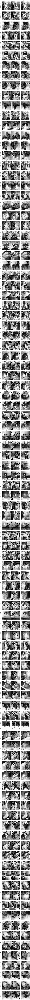

loss = 4.4508574603696616e-10 
 psnr = 141.6449737548828 
 ssim = 1.0


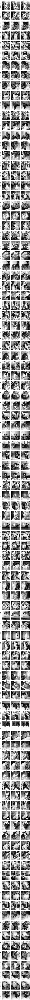

In [17]:
rand_ratio = np.concatenate(([0.01], np.arange(0.0, 1.1, 0.1)))
randpc = np.round(rand_ratio*100).astype(int)
bat_loss = np.zeros_like(randpc, float)
bat_psnr = np.zeros_like(randpc, float)
bat_ssim = np.zeros_like(randpc, float)

for j, p in enumerate([0.9, 1.0]):
#     if p != 1.: continue
    
    mask = rand.choice([0, 1], size=(img_h, img_w, img_ch), p=[1-p, p])
    x_test = np.array([x_train0[i]*mask for i in range(len(x_train0))])

    rec = amrnn.predict(x_test/255)
    mets = amrnn.test_on_batch(x_train0/255, rec)
    print('loss = {} \n psnr = {} \n ssim = {}'.format(*mets))
    bat_loss[j] = mets[0]
    bat_psnr[j] = mets[1]
    bat_ssim[j] = mets[2]

    fig, ax = plt.subplots(cap, 3, figsize=(6, cap*2))
    if cap == 1:
        ax = np.expand_dims(ax, 0)
    for i in range(cap):
        if i == 0:
            ax[i, 0].set_title('Train')
            ax[i, 1].set_title('Test, {}\% compression'.format(int(p*100)))
            ax[i, 2].set_title('Recovered')
        ax[i, 0].imshow(x_train0[i,:,:,0], 'gray')
        ax[i, 0].grid(0)
        ax[i, 0].set_title(str(i+1))
        ax[i, 0].set_xticklabels([])
        ax[i, 0].set_yticklabels([])
        ax[i, 0].set_ylabel('$H = %.2f$, $\ell_2 = %i$' \
                            %(shannonEntropy2D(x_train0[i,:,:,0]), la.norm(x_train0[i,:,:,0])))
        ax[i, 1].imshow(x_test[i,:,:,0], 'gray')
        ax[i, 1].grid(0)
        ax[i, 1].set_xticklabels([])
        ax[i, 1].set_yticklabels([])
        ax[i, 2].imshow(rec[i,:,:,0], 'gray')
        ax[i, 2].grid(0)
        ax[i, 2].set_xticklabels([])
        ax[i, 2].set_yticklabels([])

    plt.grid(False)
    plt.tight_layout(pad=0.2)
#     plt.savefig(sessiondir + '36d30_{}pcratio.png'.format(int(p*100)),
#                 dpi=300,
#                 bbox_inches='tight',
#                 transparent=True)
    plt.show()
    
plt.close('all')

In [10]:
W, U, b = amrnn.layers[1].get_weights()

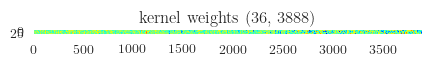

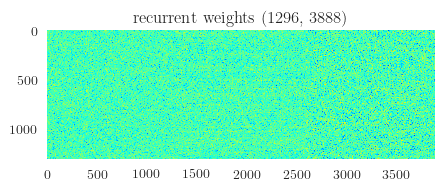

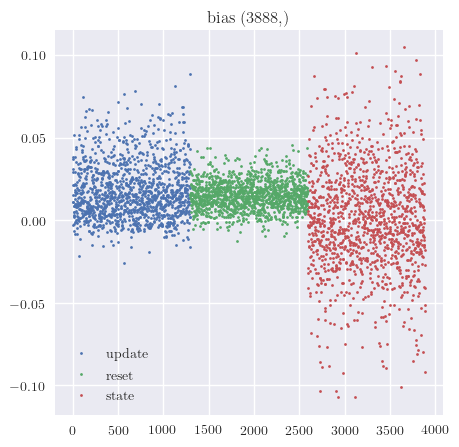

In [12]:
plt.imshow(W, 'jet')
plt.title('kernel weights ' + str(W.shape))
plt.grid(0)
# plt.savefig(sessiondir + 'gru_kernel.png', dpi=300, bbox_inches='tight')
plt.show()

plt.imshow(U, 'jet')
plt.title('recurrent weights ' + str(U.shape))
plt.grid(0)
# plt.savefig(sessiondir + 'gru_recurrent.png', dpi=300, bbox_inches='tight')
plt.show()

plt.plot(range(36**2), b[:36**2], '.', ms=4, label='update')
plt.plot(range(36**2, 36**2*2), b[36**2:36**2*2], '.', ms=4, label='reset')
plt.plot(range(36**2*2, len(b)), b[36**2*2:], '.', ms=4, label='state')
plt.title('bias ' + str(b.shape))
plt.legend()
# plt.savefig(sessiondir + 'gru_bias.png', dpi=300, bbox_inches='tight')
plt.show()

In [13]:
W, b = amrnn.layers[2].get_weights()

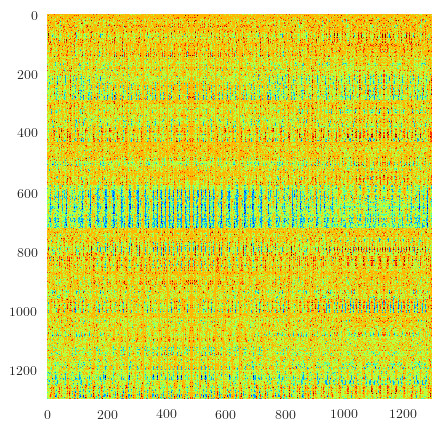

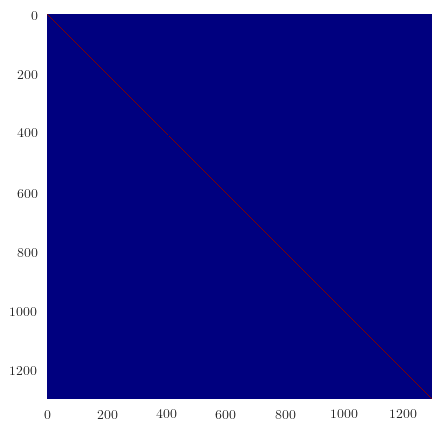

In [13]:
plt.imshow(abs(fft.ifft(np.identity(36**2))), 'jet')
plt.grid(0)
# plt.savefig(sessiondir + 'fft_matrix.png', dpi=300, bbox_inches='tight')
plt.show()

plt.imshow(abs(fft.idct(np.identity(36**2))), 'jet')
plt.grid(0)
# plt.savefig(sessiondir + 'dct_matrix.png', dpi=300, bbox_inches='tight')
plt.show()

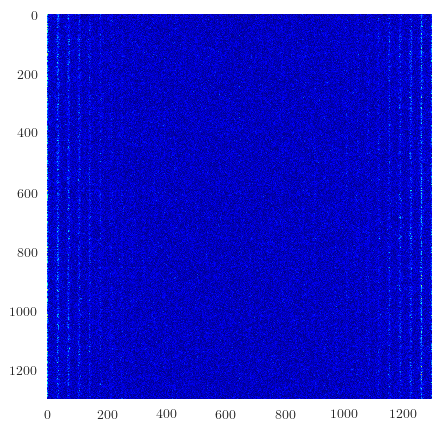

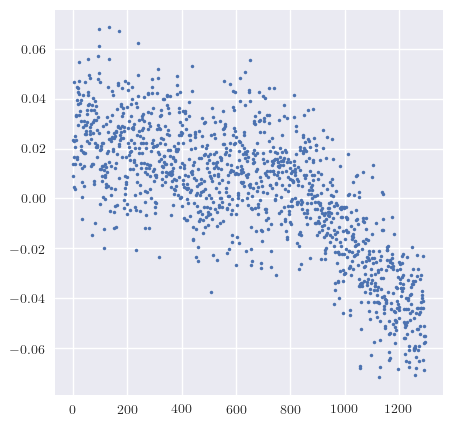

In [15]:
plt.imshow(abs(fft.ifft(W)), 'jet')
plt.grid(0)
# plt.savefig(sessiondir + 'fc_kernel.png', dpi=300, bbox_inches='tight')
plt.show()

plt.plot(b, '.', ms=5)
# plt.savefig(sessiondir + 'fc_bias.png', dpi=300, bbox_inches='tight')
plt.show()

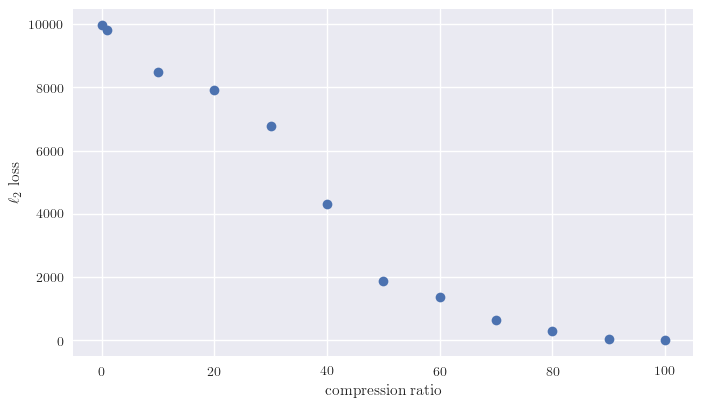

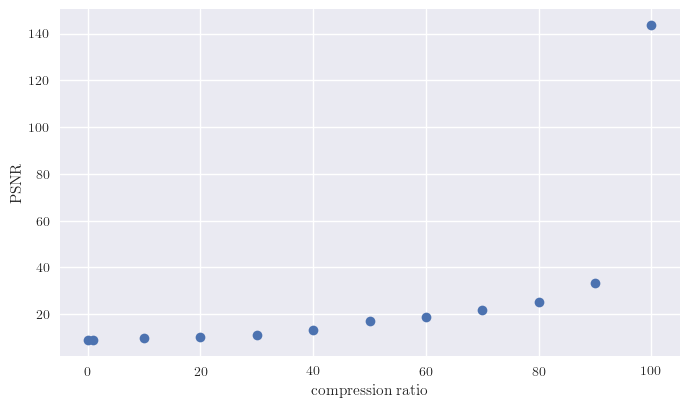

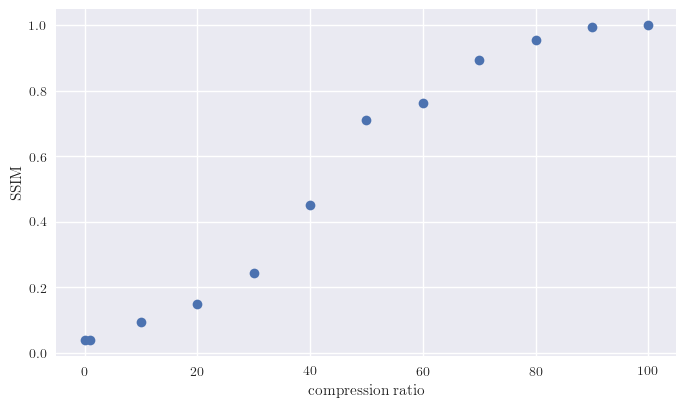

In [17]:
plt.plot(randpc, bat_loss, 'o')
plt.xlabel('compression ratio')
plt.ylabel('$\ell_2$ loss')
# plt.savefig(sessiondir + '49d33_random_loss.png',
#            dpi=300, bbox_inches='tight')
plt.show()

plt.plot(randpc, bat_psnr, 'o')
plt.xlabel('compression ratio')
plt.ylabel('PSNR')
# plt.savefig(sessiondir + '49d33_random_psnr.png',
#            dpi=300, bbox_inches='tight')
plt.show()

plt.plot(randpc, bat_ssim, 'o')
plt.xlabel('compression ratio')
plt.ylabel('SSIM')
# plt.savefig(sessiondir + '49d33_random_ssim.png',
#            dpi=300, bbox_inches='tight')
plt.show()

loss = 11.003836631774902 
 psnr = 40.712890625 
 ssim = 0.9969223141670227


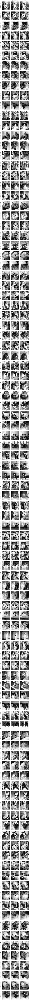

loss = 457.0037841796875 
 psnr = 25.037757873535156 
 ssim = 0.90093594789505


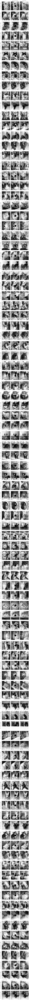

loss = 2199.612060546875 
 psnr = 16.930950164794922 
 ssim = 0.624880850315094


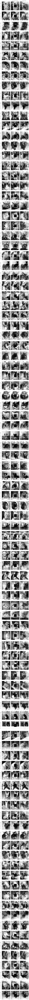

loss = 3948.589111328125 
 psnr = 13.371748924255371 
 ssim = 0.41242077946662903


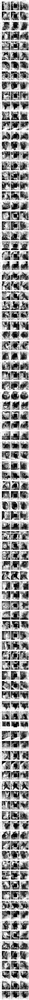

loss = 5232.00146484375 
 psnr = 11.770400047302246 
 ssim = 0.3042859137058258


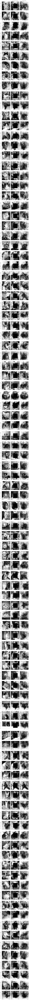

loss = 5841.29736328125 
 psnr = 11.125787734985352 
 ssim = 0.2639223635196686


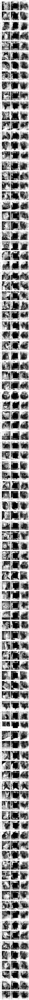

loss = 7097.11083984375 
 psnr = 9.96936321258545 
 ssim = 0.17429664731025696


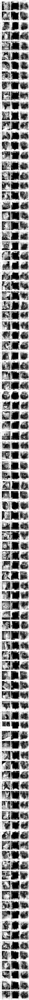

loss = 7737.78125 
 psnr = 9.490159034729004 
 ssim = 0.12578459084033966


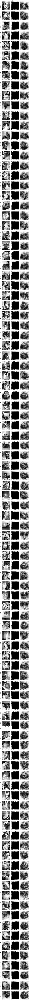

loss = 7908.23291015625 
 psnr = 9.34543228149414 
 ssim = 0.10225167870521545


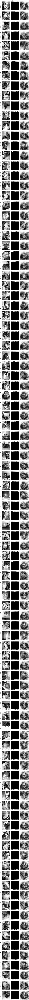

loss = 9597.072265625 
 psnr = 8.433940887451172 
 ssim = 0.022479647770524025


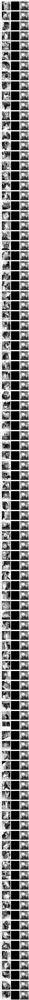

In [19]:
border_percent = np.arange(0.1, 1.1, 0.1)
borderpc = np.round(border_percent*100).astype(int)
bat_loss = np.zeros_like(border_percent)
bat_psnr = np.zeros_like(border_percent)
bat_ssim = np.zeros_like(border_percent)

for j, b in enumerate(border_percent):
    border_mask = np.ones_like(x_train0[0])
    L = len(border_mask)
    border_size = int(L*b)//2
    border_mask[L//2-border_size : L//2+border_size+1, 
                L//2-border_size : L//2+border_size+1] = 0
    
    x_test = np.array([x_train0[i]*border_mask for i in range(len(x_train0))])

    rec = amrnn.predict(x_test/255)
    mets = amrnn.test_on_batch(x_train0/255, rec)
    bat_loss[j] = mets[0]
    bat_psnr[j] = mets[1]
    bat_ssim[j] = mets[2]
    print('loss = {} \n psnr = {} \n ssim = {}'.format(*mets))

    fig, ax = plt.subplots(cap, 3, figsize=(6, cap*2))
    if cap == 1:
        ax = np.expand_dims(ax, 0)
    for i in range(cap):
        if i == 0:
            ax[i, 0].set_title('Train')
            ax[i, 1].set_title('Test, {}\% center'.format(str(borderpc[j])))
            ax[i, 2].set_title('Recovered')
        ax[i, 0].imshow(x_train0[i,:,:,0], 'gray')
        ax[i, 0].grid(0)
        ax[i, 0].set_title(str(i+1))
        ax[i, 0].set_xticklabels([])
        ax[i, 0].set_yticklabels([])
        ax[i, 0].set_ylabel('$H = %.2f$, $\ell_2 = %i$' \
                            %(shannonEntropy2D(x_train0[i,:,:,0]), la.norm(x_train0[i,:,:,0])))
        ax[i, 1].imshow(x_test[i,:,:,0], 'gray')
        ax[i, 1].grid(0)
        ax[i, 1].set_xticklabels([])
        ax[i, 1].set_yticklabels([])
        ax[i, 2].imshow(rec[i,:,:,0], 'gray')
        ax[i, 2].grid(0)
        ax[i, 2].set_xticklabels([])
        ax[i, 2].set_yticklabels([])

#     mp.savefig(sessiondir + '3inputs' + n + '.png',
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
    plt.grid(False)
    plt.tight_layout(pad=0.2)
    plt.show()
plt.close('all')

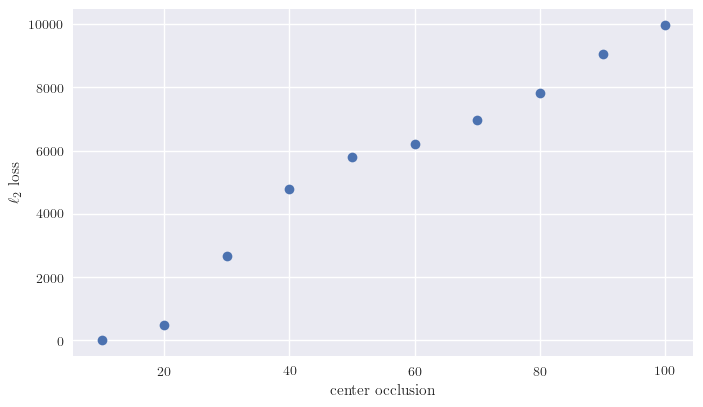

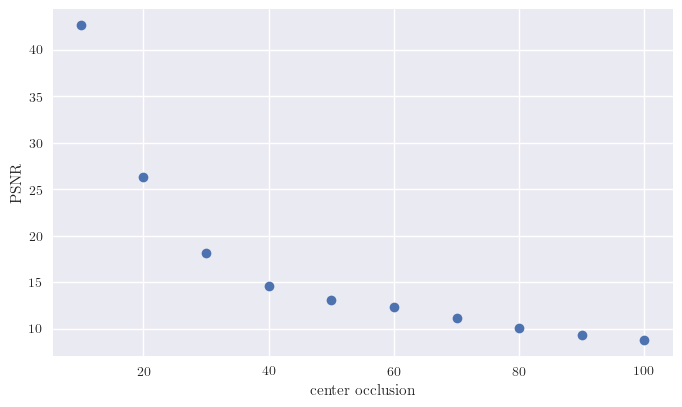

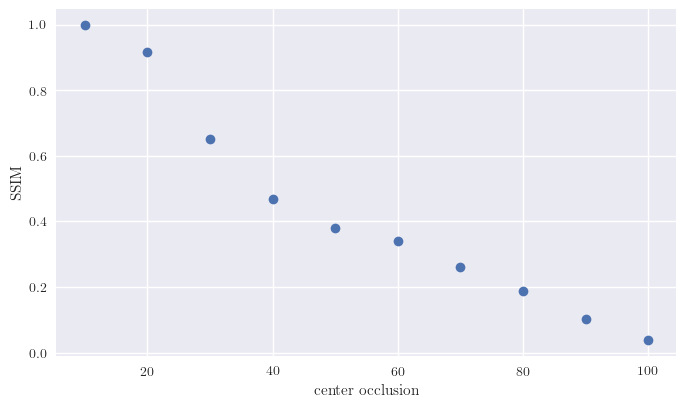

In [19]:
plt.plot(borderpc, bat_loss, 'o')
plt.xlabel('center occlusion')
plt.ylabel('$\ell_2$ loss')
# plt.savefig(sessiondir + '49d33_border_loss.png',
#            dpi=300, bbox_inches='tight')
plt.show()

plt.plot(borderpc, bat_psnr, 'o')
plt.xlabel('center occlusion')
plt.ylabel('PSNR')
# plt.savefig(sessiondir + '49d33_border_psnr.png',
#            dpi=300, bbox_inches='tight')
plt.show()

plt.plot(borderpc, bat_ssim, 'o')
plt.xlabel('center occlusion')
plt.ylabel('SSIM')
# plt.savefig(sessiondir + '49d33_border_ssim.png',
#            dpi=300, bbox_inches='tight')
plt.show()

In [22]:
bat_epoch = []
bat_loss = []
bat_psnr = []
bat_ssim = []
cap = 39
caps = np.arange(cap, dtype=int)

filenames = os.listdir()
files = np.sort([int(f.split('_')[0][3:]) for f in filenames if (f.endswith('.csv') and f.startswith('36'))])
files = ['36d' + str(f) + '_trainlog.csv' for f in files]
for f in files:
    l_epoch, l_loss, l_psnr, l_ssim = np.genfromtxt(f,
                                                    delimiter=',',
                                                    skip_header=1,
                                                    unpack=True)
    bat_epoch.append(l_epoch[-1])
    
    bat_loss.append(l_loss[-1])
    bat_psnr.append(l_psnr[-1])
    bat_ssim.append(l_ssim[-1])

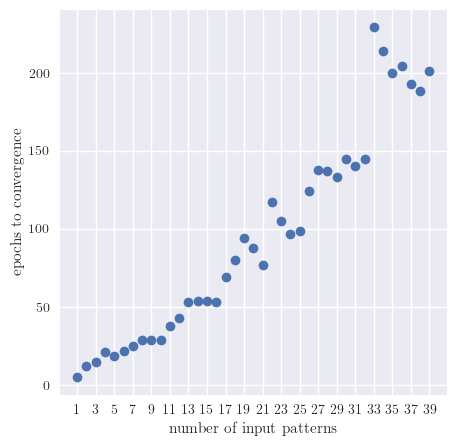

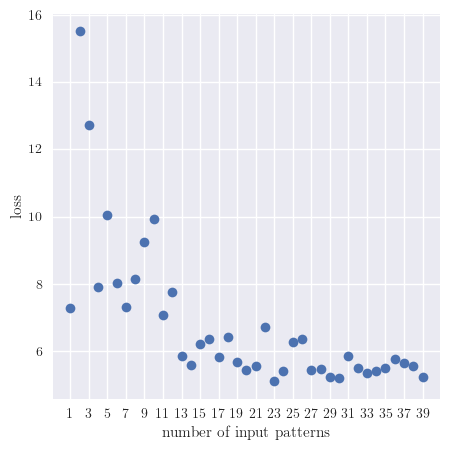

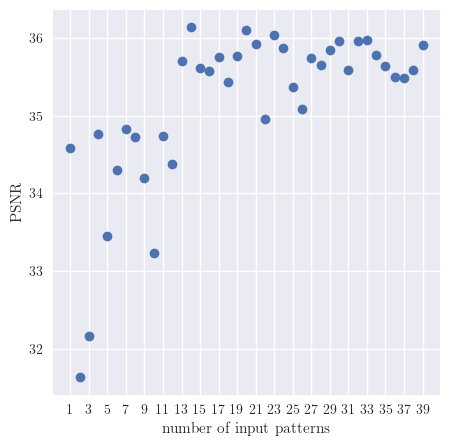

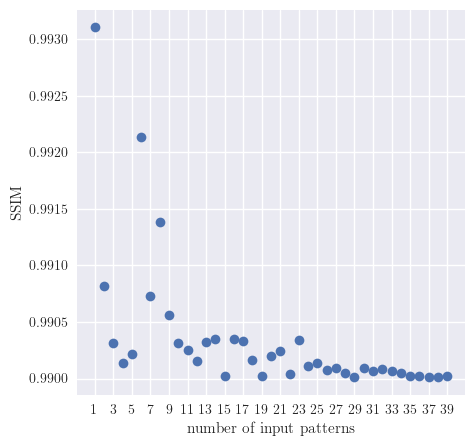

In [41]:
plt.plot(caps, bat_epoch, 'o')
plt.xlabel('number of input patterns')
plt.ylabel('epochs to convergence')
plt.xticks(np.arange(0, cap, 2), np.arange(1, cap+1, 2))
# plt.savefig(sessiondir + '36d30_epoch.png', dpi=300, bbox_inches='tight')
plt.show()

plt.plot(caps, bat_loss, 'o')
plt.xlabel('number of input patterns')
plt.ylabel('loss')
plt.xticks(np.arange(0, cap, 2), np.arange(1, cap+1, 2))
# plt.savefig(sessiondir + '36d30_loss.png', dpi=300, bbox_inches='tight')
plt.show()

plt.plot(caps, bat_psnr, 'o')
plt.xlabel('number of input patterns')
plt.ylabel('PSNR')
plt.xticks(np.arange(0, cap, 2), np.arange(1, cap+1, 2))
# plt.savefig(sessiondir + '36d30_psnr.png', dpi=300, bbox_inches='tight')
plt.show()

plt.plot(caps, bat_ssim, 'o')
plt.xlabel('number of input patterns')
plt.ylabel('SSIM')
plt.xticks(np.arange(0, cap, 2), np.arange(1, cap+1, 2))
# plt.savefig(sessiondir + '36d30_ssim.png', dpi=300, bbox_inches='tight')
plt.show()